<a href="https://colab.research.google.com/github/YajatMittal/Skin-Cancer-Detection/blob/main/Skin_Cancer_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Importing Dependencies





In [11]:
import tensorflow as tf
from tensorflow import keras
from keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
import matplotlib.pyplot as plt
import glob

#Loading Dataset

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Unzipping The Dataset

In [ ]:
!unzip /content/drive/MyDrive/Datasets/archive.zip

Streaming output truncated to the last 5000 lines.
  inflating: data/train/benign/420.jpg  
  inflating: data/train/benign/421.jpg  
  inflating: data/train/benign/422.jpg  
  inflating: data/train/benign/423.jpg  
  inflating: data/train/benign/424.jpg  
  inflating: data/train/benign/425.jpg  
  inflating: data/train/benign/426.jpg  
  inflating: data/train/benign/429.jpg  
  inflating: data/train/benign/43.jpg  
  inflating: data/train/benign/430.jpg  
  inflating: data/train/benign/431.jpg  
  inflating: data/train/benign/432.jpg  
  inflating: data/train/benign/434.jpg  
  inflating: data/train/benign/435.jpg  
  inflating: data/train/benign/438.jpg  
  inflating: data/train/benign/439.jpg  
  inflating: data/train/benign/440.jpg  
  inflating: data/train/benign/441.jpg  
  inflating: data/train/benign/442.jpg  
  inflating: data/train/benign/443.jpg  
  inflating: data/train/benign/445.jpg  
  inflating: data/train/benign/446.jpg  
  inflating: data/train/benign/447.jpg  
  infla

# Visualising Images

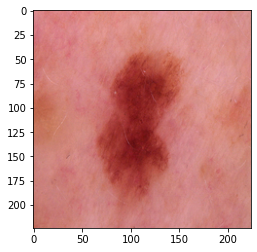

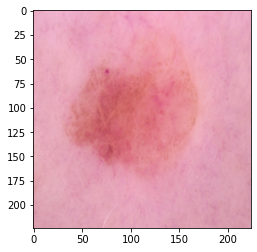

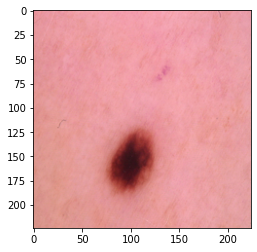

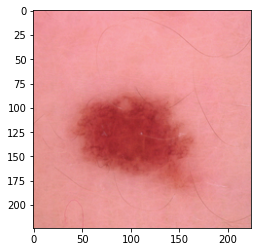

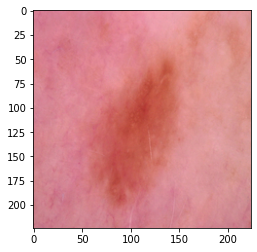

...

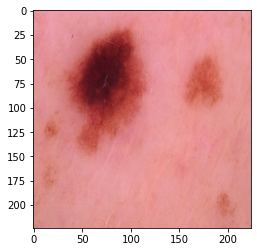

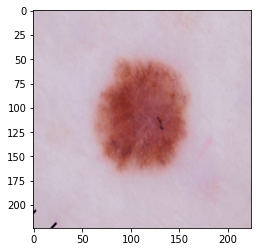

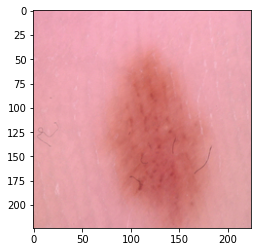

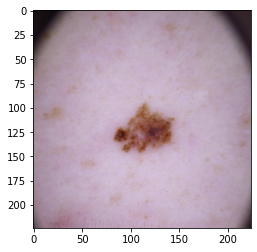

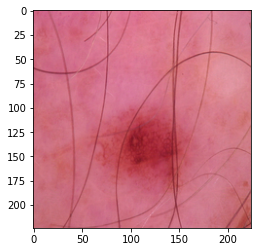

In [12]:
for image in glob.glob(f'/content/data/test/benign/*'): 
  img = plt.imread(image)
  plt.imshow(img)
  plt.show()


# Image Preprocessing & Image Augmentation

In [ ]:
train_dir = '/content/data/train/'
#Data Augmentation
train_datagen = ImageDataGenerator(
                                   rescale=1/255,
                                   rotation_range = 40,
                                   width_shift_range = 0.2,
                                   height_shift_range = 0.2,
                                   shear_range = 0.2,
                                   zoom_range = 0.2,
                                   horizontal_flip = True
                                   
)
#train_generator will assign binary labels to the images
train_generator = train_datagen.flow_from_directory(
                                        train_dir,
                                        target_size =(224,224),
                                        class_mode = 'binary',
                                        batch_size = 293,                  
)

validate_dir = '/content/data/test/'
#Data Augmentation
validate_datagen = ImageDataGenerator(
                                   rescale=1/255,
                                   rotation_range = 40,
                                   width_shift_range = 0.2,
                                   height_shift_range = 0.2,
                                   shear_range = 0.2,
                                   zoom_range = 0.2,
                                   horizontal_flip = True
                                   
)
#validation_generator will assign binary labels to the images
validation_generator = validate_datagen.flow_from_directory(
                                        validate_dir,
                                        target_size = (224,224),
                                        class_mode = 'binary',
                                        batch_size = 60
                                        
)

Found 2637 images belonging to 2 classes.
Found 660 images belonging to 2 classes.


#Making The Model - CNNs

In [9]:
model = keras.Sequential([keras.layers.Conv2D(16,(3,3), activation="relu",input_shape=(224,224,3)),
                          keras.layers.MaxPool2D((2,2)),
                          keras.layers.Conv2D(32,(3,3), activation="relu"),
                          keras.layers.MaxPool2D((2,2)),
                          keras.layers.Conv2D(64,(3,3), activation="relu"),
                          keras.layers.MaxPool2D((2,2)),
                          keras.layers.Flatten(),
                          keras.layers.Dense(512, activation="relu"),
                          keras.layers.Dense(1, activation="sigmoid")
])

model.summary()
model.compile(loss="binary_crossentropy", optimizer=Adam(1e-3), metrics=['accuracy'])
model.fit(train_generator, epochs=10,steps_per_epoch=9, validation_data = validation_generator, validation_steps=11)

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_9 (Conv2D)           (None, 222, 222, 16)      448       
                                                                 
 max_pooling2d_9 (MaxPooling  (None, 111, 111, 16)     0         
 2D)                                                             
                                                                 
 conv2d_10 (Conv2D)          (None, 109, 109, 32)      4640      
                                                                 
 max_pooling2d_10 (MaxPoolin  (None, 54, 54, 32)       0         
 g2D)                                                            
                                                                 
 conv2d_11 (Conv2D)          (None, 52, 52, 64)        18496     
                                                                 
 max_pooling2d_11 (MaxPoolin  (None, 26, 26, 64)      